## `Project Title: Credit Card Default Prediction`

### `Introduction:`

Financial institutions face the challenge of predicting credit risk to assess the likelihood of borrowers defaulting on their credit card payments. Accurate prediction of credit default is crucial for managing risk and making informed lending decisions. This project aims to develop a machine learning model that predicts the probability of credit default based on credit card owner's characteristics and payment history.


## Life cycle of Machine learning Project

- `Understanding the Problem Statement`
- `Data Collection`
- `Data Checks to perform`
- `Exploratory data analysis`
- `Data Pre-Processing (Feature Engineering and Feature Selection)`
- `Model Training`
- `Hypeparameter Tuning`
- `Choose best model`


### Problem Statement:

`The primary objective of this project is to predict the probability of credit card default based on the credit card owner's characteristics and payment history. By analyzing historical data and employing machine learning algorithms, the model will learn patterns and relationships between various features and the likelihood of default. This predictive model will assist financial institutions in assessing credit risk and taking appropriate measures to minimize potential losses.
`

### Project Details:

`- Domain: Banking`
`- Difficulty Level: Intermediate`
`- Technologies: Machine Learning`
`- Programming Language: Python 3.10`
`- Libraries: NumPy, Pandas, Matplotlib, Seaborn, cuDF (for GPU-accelerated data analysis), Flask (for creating a web application), Joblib (for saving and loading models), Dill (for serializing Python objects), PyMongo (for interacting with MongoDB)`

### Approach:

`The project will follow a typical machine learning workflow, including data exploration, data cleaning, feature engineering, model building, and model testing. Various machine learning algorithms will be experimented with to determine the most suitable approach for the credit card default prediction task. The cuDF library will be used for efficient data manipulation and analysis, taking advantage of GPU acceleration for faster computations.`

### Expected Results:

`The project aims to develop a robust machine learning solution that can accurately predict the probability of credit card default. The trained model will be capable of taking in credit card owner's characteristics and payment history as input and output the probability of default. This prediction capability will help financial institutions in making informed decisions regarding credit risk assessment and mitigating potential losses.`


# `Import the necessary libraries:`


In [ ]:
import numpy


: 

In [ ]:
import os
# import cudf 
# import cupy as cp
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots


import warnings
# Filter out a specific warning category
warnings.filterwarnings("ignore")


: 

# `Data Collection`


In [6]:
# URL of the CSV file : 'https://www.kaggle.com/uciml/default-of-credit-card-clients-dataset?select=UCI_Credit_Card.csv'

# Read the Excel file from the URL using pandas
df = cudf.read_csv('./data/UCI_Credit_Card.csv')

# Rename the 'default.payment.next.month' column to 'DEFAULT'
df = df.rename(columns={'default.payment.next.month': 'DEFAULT'})

# Save the modified DataFrame to a new file
file_path = './data/UCI_Credit_Card_modified.csv'
df.to_csv(file_path, index=False)

# Dataset Information

`This dataset contains information on default payments, demographic factors, credit data, history of payment, and bill statements of credit card clients in Taiwan from April 2005 to September 2005.`


#### Show Top 5 Records


In [7]:
df.head()

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,DEFAULT
0,1,20000.0,2,2,1,24,2,2,-1,-1,...,0.0,0.0,0.0,0.0,689.0,0.0,0.0,0.0,0.0,1
1,2,120000.0,2,2,2,26,-1,2,0,0,...,3272.0,3455.0,3261.0,0.0,1000.0,1000.0,1000.0,0.0,2000.0,1
2,3,90000.0,2,2,2,34,0,0,0,0,...,14331.0,14948.0,15549.0,1518.0,1500.0,1000.0,1000.0,1000.0,5000.0,0
3,4,50000.0,2,2,1,37,0,0,0,0,...,28314.0,28959.0,29547.0,2000.0,2019.0,1200.0,1100.0,1069.0,1000.0,0
4,5,50000.0,1,2,1,57,-1,0,-1,0,...,20940.0,19146.0,19131.0,2000.0,36681.0,10000.0,9000.0,689.0,679.0,0


# Content

`There are 25 variables:`

- ID: ID of each client
- LIMIT_BAL: Amount of given credit in NT dollars (includes individual and family/supplementary credit
- SEX: Gender (1=male, 2=female)
- EDUCATION: (1=graduate school, 2=university, 3=high school, 4=others, 5=unknown, 6=unknown)
- MARRIAGE: Marital status (1=married, 2=single, 3=others)
- AGE: Age in years
- PAY_0: Repayment status in September, 2005 (-1=pay duly, 1=payment delay for one month, 2=payment delay for two months, … 8=payment delay for eight months, 9=payment delay for nine months and above)
- PAY_2: Repayment status in August, 2005 (scale same as above)
- PAY_3: Repayment status in July, 2005 (scale same as above)
- PAY_4: Repayment status in June, 2005 (scale same as above)
- PAY_5: Repayment status in May, 2005 (scale same as above)
- PAY_6: Repayment status in April, 2005 (scale same as above)
- BILL_AMT1: Amount of bill statement in September, 2005 (NT dollar)
- BILL_AMT2: Amount of bill statement in August, 2005 (NT dollar)
- BILL_AMT3: Amount of bill statement in July, 2005 (NT dollar)
- BILL_AMT4: Amount of bill statement in June, 2005 (NT dollar)
- BILL_AMT5: Amount of bill statement in May, 2005 (NT dollar)
- BILL_AMT6: Amount of bill statement in April, 2005 (NT dollar)
- PAY_AMT1: Amount of previous payment in September, 2005 (NT dollar)
- PAY_AMT2: Amount of previous payment in August, 2005 (NT dollar)
- PAY_AMT3: Amount of previous payment in July, 2005 (NT dollar)
- PAY_AMT4: Amount of previous payment in June, 2005 (NT dollar)
- PAY_AMT5: Amount of previous payment in May, 2005 (NT dollar)
- PAY_AMT6: Amount of previous payment in April, 2005 (NT dollar)
- DEFAULT: Default payment (1=yes, 0=no)


# `Data Checks to perform`


In [8]:
def explore_data(data):
    # Check for missing values
    missing_values = data.isnull().sum()
    print("Missing Values:\n", missing_values)

    # Check for duplicates
    duplicates = data.duplicated().sum()
    print("\nNumber of Duplicates:", duplicates)

    # Check data types
    data_types = data.dtypes
    print("\nData Types:\n", data_types)

    # Check the number of unique values of each column
    unique_values = data.nunique()
    print("\nNumber of Unique Values:\n", unique_values)

    # Check statistics of the dataset
    data_stats = data.describe()
    print("\nData Statistics:\n", data_stats)

    # Exploring the data
    print("\nData Head:")
    print(data.head())

    print("\nData Tail:")
    print(data.tail())

    print("\nData Sample:")
    print(data.sample(5))

In [9]:
explore_data(df)

Missing Values:
 ID           0
LIMIT_BAL    0
SEX          0
EDUCATION    0
MARRIAGE     0
AGE          0
PAY_0        0
PAY_2        0
PAY_3        0
PAY_4        0
PAY_5        0
PAY_6        0
BILL_AMT1    0
BILL_AMT2    0
BILL_AMT3    0
BILL_AMT4    0
BILL_AMT5    0
BILL_AMT6    0
PAY_AMT1     0
PAY_AMT2     0
PAY_AMT3     0
PAY_AMT4     0
PAY_AMT5     0
PAY_AMT6     0
DEFAULT      0
dtype: int64

Number of Duplicates: 0

Data Types:
 ID             int64
LIMIT_BAL    float64
SEX            int64
EDUCATION      int64
MARRIAGE       int64
AGE            int64
PAY_0          int64
PAY_2          int64
PAY_3          int64
PAY_4          int64
PAY_5          int64
PAY_6          int64
BILL_AMT1    float64
BILL_AMT2    float64
BILL_AMT3    float64
BILL_AMT4    float64
BILL_AMT5    float64
BILL_AMT6    float64
PAY_AMT1     float64
PAY_AMT2     float64
PAY_AMT3     float64
PAY_AMT4     float64
PAY_AMT5     float64
PAY_AMT6     float64
DEFAULT        int64
dtype: object

Number of Unique

# Insights:

- We have no missing values in the dataset.
- We have no duplicated values in the dataset.

`Here we have Catagorical columns:`

- 'ID',
- 'SEX',
- 'EDUCATION',
- 'MARRIAGE',
- 'AGE',
- 'PAY_0',
- 'PAY_2',
- 'PAY_3',
- 'PAY_4',
- 'PAY_5',
- 'PAY_6',
- 'DEFAULT'

`Numerical columns:`

- 'LIMIT_BAL',
- 'BILL_AMT1',
- 'BILL_AMT2',
- 'BILL_AMT3',
- 'BILL_AMT4',
- 'BILL_AMT5',
- 'BILL_AMT6',
- 'PAY_AMT1',
- 'PAY_AMT2',
- 'PAY_AMT3',
- 'PAY_AMT4',
- 'PAY_AMT5',
- 'PAY_AMT6',


In [10]:
# ID column has no use, so lets drop it
df = df.drop('ID', axis=1)

In [11]:
# Assuming the dataframe is named 'df'
numerical_columns = ['LIMIT_BAL', 'BILL_AMT1', 'BILL_AMT2', 'BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5', 'BILL_AMT6',
                     'PAY_AMT1', 'PAY_AMT2', 'PAY_AMT3', 'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6', 'AGE']

categorical_columns = ['SEX', 'EDUCATION', 'MARRIAGE', 'PAY_0',
                       'PAY_2', 'PAY_3', 'PAY_4', 'PAY_5', 'PAY_6', 'DEFAULT']

# Creating separate dataframes for numerical and categorical columns
numerical_df = df[numerical_columns]
categorical_df = df[categorical_columns]

# `Univariate data analysis on categorical_columns`


In [12]:
def plot_categorical_charts(dataframe):
    # Convert cuDF DataFrame to pandas DataFrame
    dataframe = dataframe.to_pandas()
    # Loop through each categorical column
    for column in dataframe.columns:
        # Compute the count of each category in the column
        category_counts = dataframe[column].value_counts()

        # Create a pie chart using Plotly
        fig_pie = go.Figure(data=[go.Pie(labels=category_counts.index, values=category_counts.values,
                                         textinfo='percent+label', insidetextorientation='radial',
                                         marker=dict(line=dict(color='#ffffff', width=2)))])
        fig_pie.update_layout(title=f'Distribution of {column}', title_font=dict(size=20),
                              legend=dict(font=dict(size=12), title_font=dict(size=14)))

        # Create a bar chart using Plotly
        fig_bar = go.Figure(data=[go.Bar(x=category_counts.index, y=category_counts.values,
                                         marker_color='#1f77b4', textposition='auto',
                                         hovertemplate='%{x}<br>Count: %{y}')])
        fig_bar.update_layout(title=f'Distribution of {column} (Bar Chart)', xaxis=dict(title=column), yaxis=dict(title='Count'),
                              hovermode='closest', template='plotly_white')
        fig_bar.update_traces(
            texttemplate='%{y}', textfont=dict(color='white'))

        # Show the pie chart
        fig_pie.show()

        # Show the bar chart
        fig_bar.show()


plot_categorical_charts(categorical_df)

## Insights:

- `The dataset is highly inbalance dataset.`


# `Univariate data analysis on numerical_columns`


In [13]:
def plot_numerical_charts(dataframe):
    # Convert cuDF DataFrame to pandas DataFrame
    dataframe = dataframe.to_pandas()

    # Define color palette
    box_color = '#1f77b4'  # blue
    hist_color = '#ff7f0e'  # orange

    # Loop through each numerical column
    for column in dataframe.columns:
        # Create a box plot using Plotly Express
        fig_box = px.box(
            dataframe, y=column, title=f'Box Plot: {column}', color_discrete_sequence=[box_color])

        # Create a histogram using Plotly Express
        fig_hist = px.histogram(dataframe, x=column, nbins=30, histnorm='density', title=f'Histogram: {column}',
                                color_discrete_sequence=[hist_color])

        # Create subplots to display the box plot and histogram side by side
        fig_combined = make_subplots(rows=1, cols=2, subplot_titles=(
            f'Box Plot: {column}', f'Histogram: {column}'))
        fig_combined.add_trace(fig_box.data[0], row=1, col=1)
        fig_combined.add_trace(fig_hist.data[0], row=1, col=2)
        fig_combined.update_layout(height=500, width=900, showlegend=False)

        # Update layout for box plot
        fig_combined.update_xaxes(title_text=column, row=1, col=1)
        fig_combined.update_yaxes(title_text='', row=1, col=1)

        # Update layout for histogram
        fig_combined.update_xaxes(title_text=column, row=1, col=2)
        fig_combined.update_yaxes(title_text='Density', row=1, col=2)

        # Show the combined chart
        fig_combined.show()


# Call the function with your numerical dataframe
plot_numerical_charts(numerical_df)

## Insights:

- `The dataset has a lot of outlairs.`
- `Even most of the features are not normally distributed.`


# `Pair Plot`


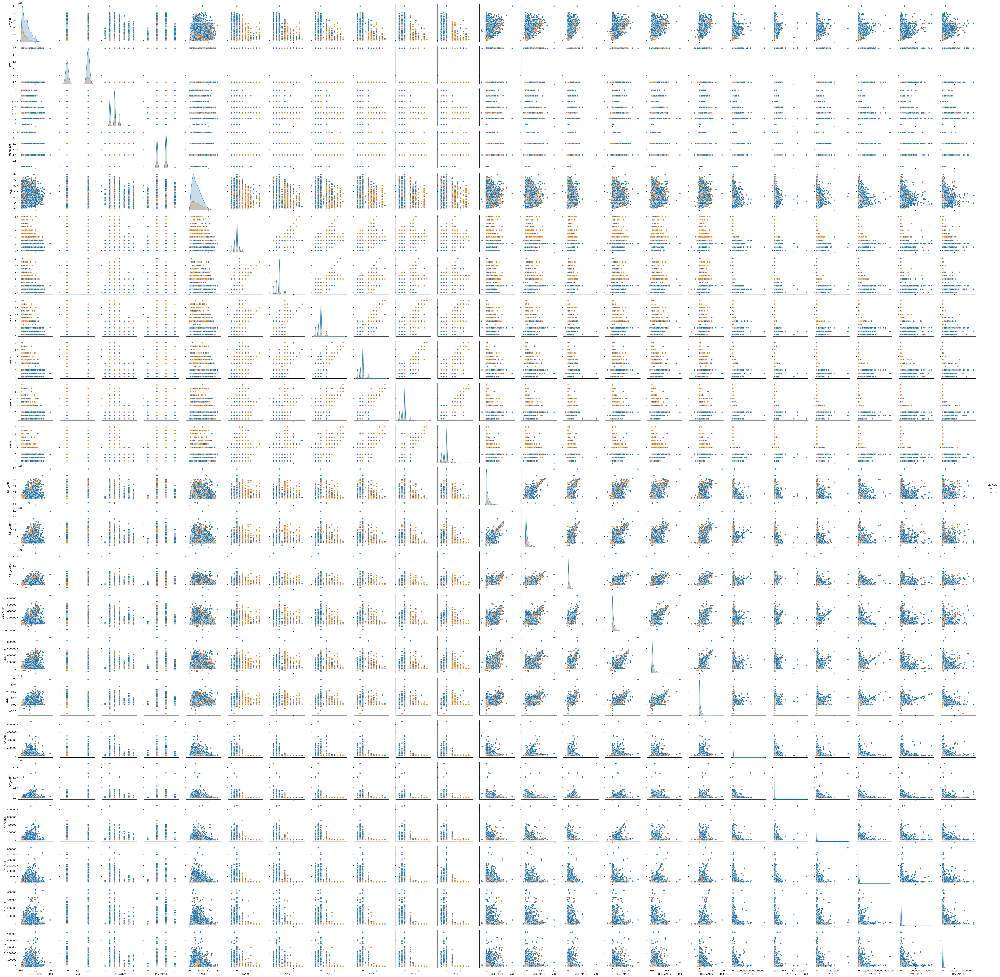

Execution time: 399.74 seconds


In [11]:
import time
# Select a subset of columns for the pair plot
columns = ['LIMIT_BAL',
           'SEX',
           'EDUCATION',
           'MARRIAGE',
           'AGE',
           'PAY_0',
           'PAY_2',
           'PAY_3',
           'PAY_4',
           'PAY_5',
           'PAY_6',
           'BILL_AMT1',
           'BILL_AMT2',
           'BILL_AMT3',
           'BILL_AMT4',
           'BILL_AMT5',
           'BILL_AMT6',
           'PAY_AMT1',
           'PAY_AMT2',
           'PAY_AMT3',
           'PAY_AMT4',
           'PAY_AMT5',
           'PAY_AMT6',
           'DEFAULT']

# Convert the selected columns to a cuDF DataFrame
df_subset = df[columns]

# Convert the cuDF DataFrame to a pandas DataFrame
df_subset = df_subset.to_pandas()

# Measure the time taken to plot the pair plot
start_time = time.time()

# Plot the pair plot using seaborn
sns.pairplot(df_subset, hue='DEFAULT')

# Calculate the time taken
end_time = time.time()
execution_time = end_time - start_time

# Show the plot
plt.show()

# Print the execution time
print("Execution time: %.2f seconds" % execution_time)

## Insights:

`I don't see much liner relaionship by looking at this pair plot.`


# `Bivariate data analysis`


In [21]:
columns = ['LIMIT_BAL', 'SEX', 'EDUCATION', 'MARRIAGE', 'AGE', 'PAY_0', 'PAY_2', 'PAY_3', 'PAY_4', 'PAY_5', 'PAY_6', 'BILL_AMT1', 'BILL_AMT2',
           'BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5', 'BILL_AMT6', 'PAY_AMT1', 'PAY_AMT2', 'PAY_AMT3', 'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6', 'DEFAULT']

# Convert the selected columns to a pandas DataFrame
df_subset = df[columns].to_pandas()


def bivariate_analysis(data, x, y, hue=None):
    plt.figure(figsize=(15, 10))
    sns.barplot(data=data, x=x, y=y, hue=hue, palette='Set1')
    plt.xlabel(x)
    plt.ylabel(y)
    plt.title(f"Bivariate Analysis: {x} vs {y}")
    plt.legend()
    plt.show()

In [18]:
list(df)

['LIMIT_BAL',
 'SEX',
 'EDUCATION',
 'MARRIAGE',
 'AGE',
 'PAY_0',
 'PAY_2',
 'PAY_3',
 'PAY_4',
 'PAY_5',
 'PAY_6',
 'BILL_AMT1',
 'BILL_AMT2',
 'BILL_AMT3',
 'BILL_AMT4',
 'BILL_AMT5',
 'BILL_AMT6',
 'PAY_AMT1',
 'PAY_AMT2',
 'PAY_AMT3',
 'PAY_AMT4',
 'PAY_AMT5',
 'PAY_AMT6',
 'DEFAULT']

In [19]:
categorical_columns

['SEX',
 'EDUCATION',
 'MARRIAGE',
 'PAY_0',
 'PAY_2',
 'PAY_3',
 'PAY_4',
 'PAY_5',
 'PAY_6',
 'DEFAULT']

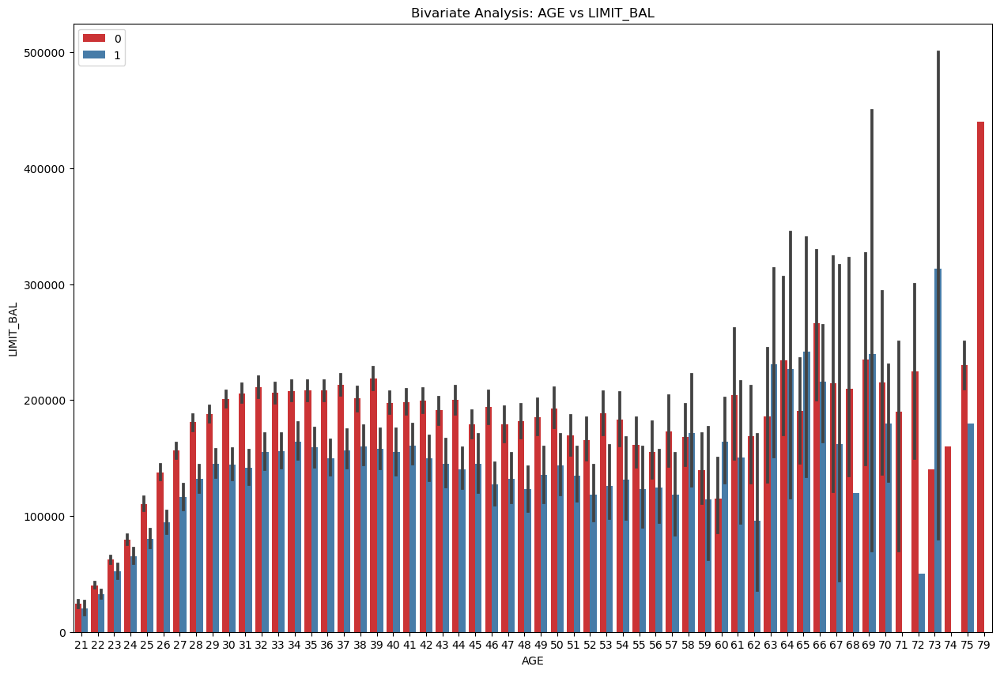

In [24]:
bivariate_analysis(data=df_subset, x='AGE', y='LIMIT_BAL', hue='DEFAULT')

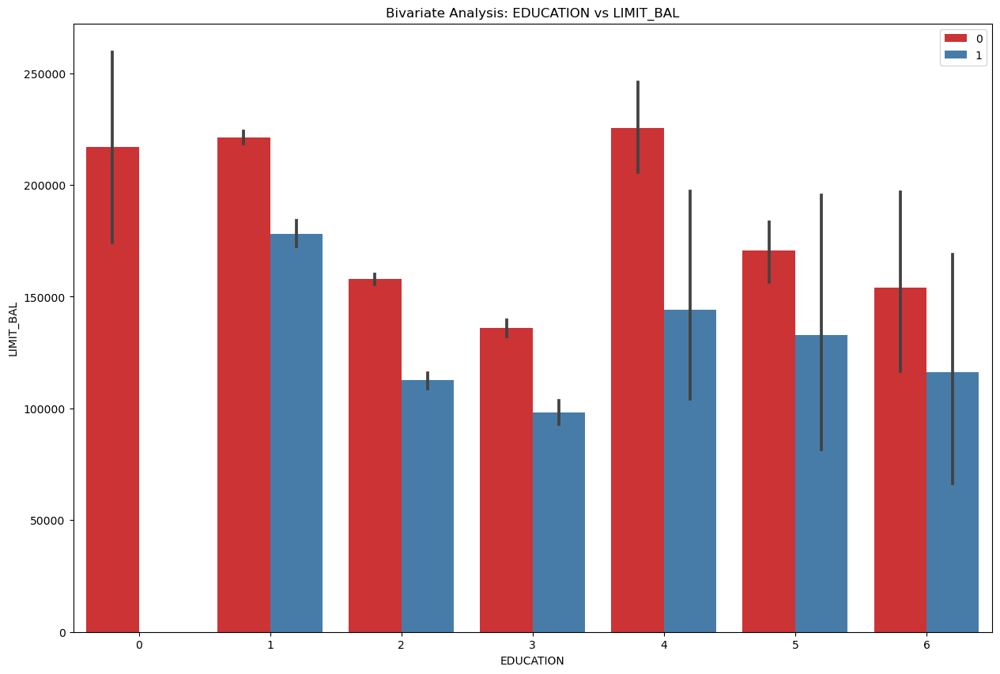

In [25]:
bivariate_analysis(data=df_subset, x='EDUCATION', y='LIMIT_BAL', hue='DEFAULT')

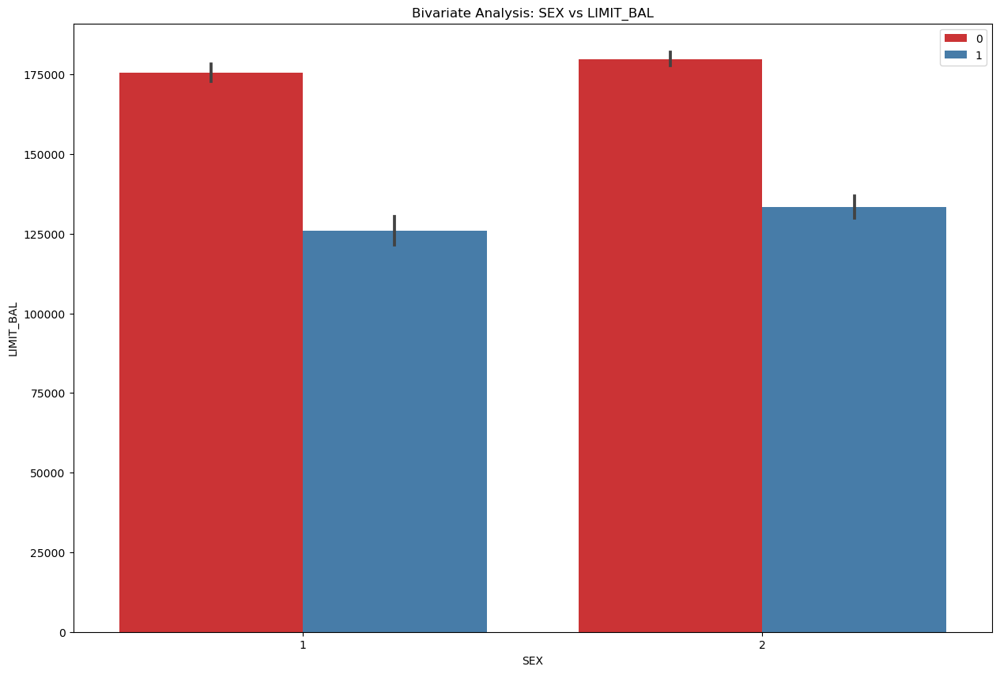

In [26]:
bivariate_analysis(data=df_subset, x='SEX', y='LIMIT_BAL', hue='DEFAULT')

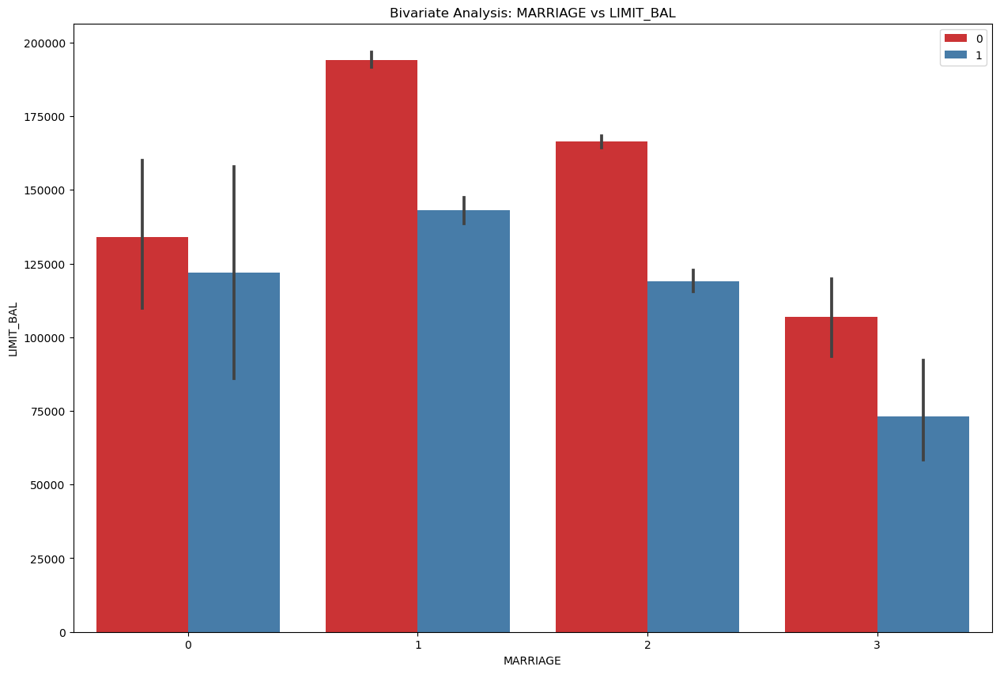

In [27]:
bivariate_analysis(data=df_subset, x='MARRIAGE', y='LIMIT_BAL', hue='DEFAULT')

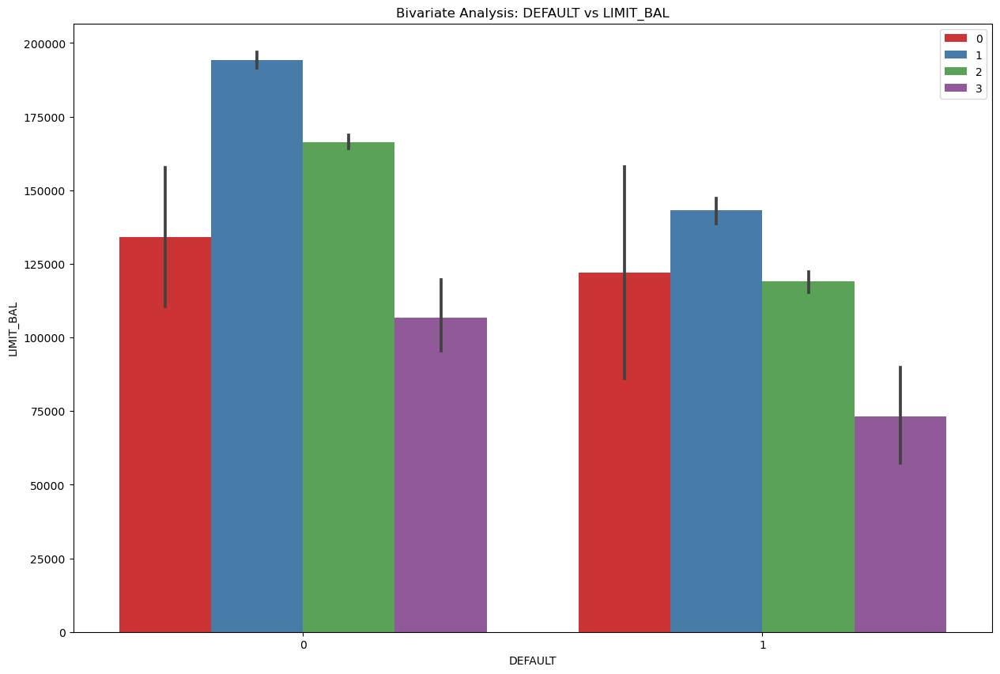

In [28]:
bivariate_analysis(data=df_subset, x='DEFAULT', y='LIMIT_BAL', hue='MARRIAGE')